# Imports COCO dataset

In [1]:
import matplotlib.pyplot as plt
from pycocotools.coco import COCO
import skimage.io as io
import math
import random

# Imports MediaPipe

In [2]:
import scipy.io
import os
import mediapipe as mp
import cv2
from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
import shutil
import time

# Imports for boths

In [3]:
import numpy as np
import pandas as pd

# Imports YOLO

In [4]:
from ultralytics import YOLO

# Load test images for model MediaPipe

In [5]:
N = 100
MEDIAPIPE_IMAGES_DIR = "./mp_keypoints"
output_folder= "./extracted_images_from_coco"

if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Load annotations from COCO dataset

In [6]:
dataDir = './coco/'
dataType = 'val2017'
annFile_kps = '{}/annotations/person_keypoints_{}.json'.format(dataDir, dataType)
coco_kps = COCO(annFile_kps)

loading annotations into memory...
Done (t=0.35s)
creating index...
index created!


# Get'person' category ID and get image ID with 'person' category and list to store true keypoints coordenates

In [7]:
catIds = coco_kps.getCatIds(catNms=['person'])
imgIds = coco_kps.getImgIds(catIds=catIds)[:10]

# Load and show images with Keypoints and get keypoints coordenates

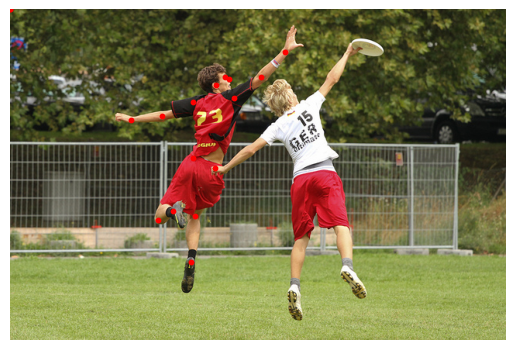

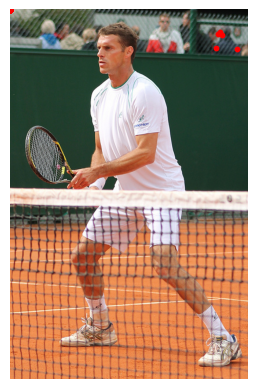

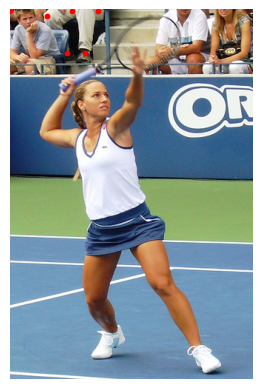

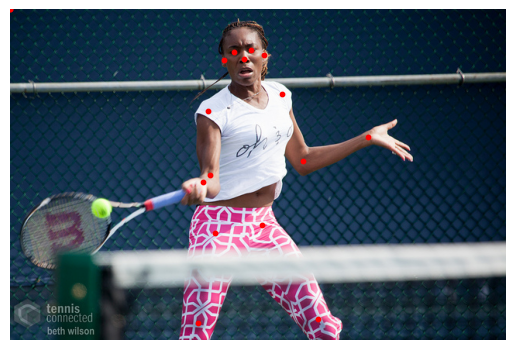

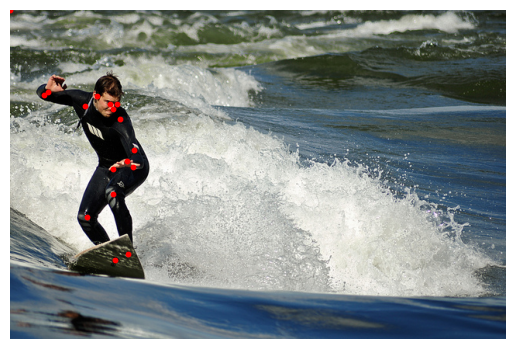

...

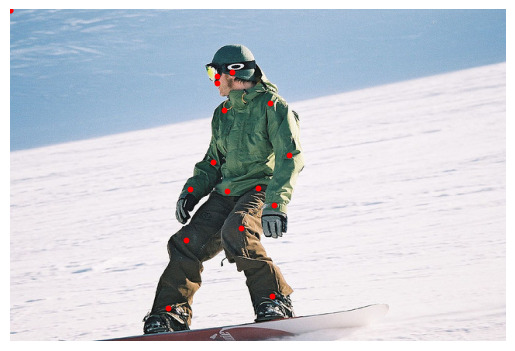

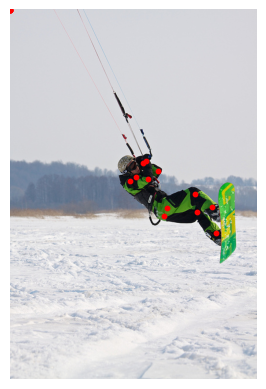

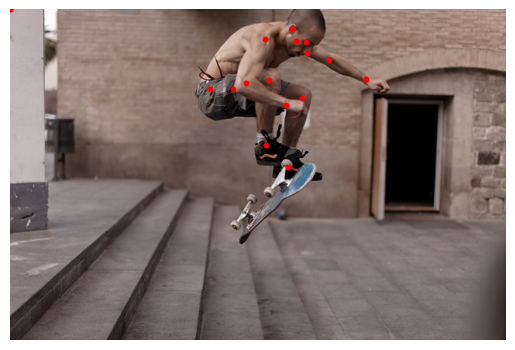

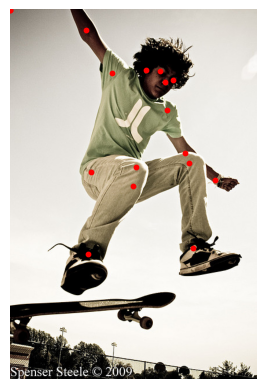

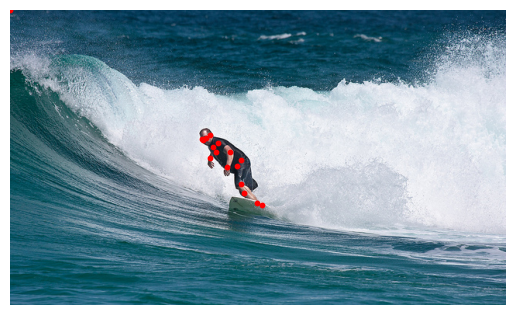

In [8]:
id_person_keypoints = [127263, 201072, 127270, 463174, 381360, 135604, 365095, 785, 263403, 320696,
                        115898, 82715, 377635, 90956, 25424, 410456, 574297, 872, 410510, 328601, 263068, 
                        99242, 476119, 33759, 320490, 140270, 197658, 361506, 82986, 574520, 427077, 427160, 
                        369323, 402118, 74457, 500478, 197388, 172649, 311928, 25228, 377486, 369310, 532481,
                        393226, 532493,434204, 188465, 475191, 81988, 507975, 516173, 32861,
                        442463, 221291, 417911, 32887, 270474, 90284, 229553, 278705, 213171, 549055, 65736,
                        360661, 516318, 295138, 33005, 65798, 205105, 352582, 57672, 123213, 336209, 262487,
                        74092, 434548, 442746, 426376, 106912, 262587, 238013, 278973, 442836, 451043, 352760,
                        205324, 451084, 98853, 254516, 33368, 259097, 364102, 378454, 409198, 343937, 80273, 563349, 68628, 125472, 190007]

true_keypoints_list = []


for imgId in id_person_keypoints:

    #print("Processing image ID:", imgId)
    
    img_info = coco_kps.loadImgs(imgId)[0]
    img_url = img_info['coco_url']
    
    
    I = io.imread(img_url)
    filename = img_url.split('/')[-1]
    output_path = os.path.join(output_folder, filename)
    
    
    io.imsave(output_path, I)
    
    
    annIds = coco_kps.getAnnIds(imgIds=imgId, catIds=catIds, iscrowd=None)
    anns = coco_kps.loadAnns(annIds)
    keypoints_per_image = []

    
    
    if len(anns) > 1:
        
        ann = random.choice(anns)
        keypoints = ann['keypoints']
        if keypoints:
            keypoints = np.array(keypoints).reshape(-1, 3)  
            x = keypoints[:, 0]
            y = keypoints[:, 1]
            plt.scatter(x, y, s=10, c='r')
            keypoints_per_image.append(keypoints.tolist())
    elif len(anns) == 1:
       
        ann = anns[0]
        keypoints = ann['keypoints']
        if keypoints:
            keypoints = np.array(keypoints).reshape(-1, 3)  
            x = keypoints[:, 0]
            y = keypoints[:, 1]
            plt.scatter(x, y, s=10, c='r')
            keypoints_per_image.append(keypoints.tolist())
    
    plt.imshow(I)
    plt.axis('off')
    plt.show()

    true_keypoints_list.append(keypoints_per_image)

# Model MediaPipe

In [30]:
if not os.path.exists(MEDIAPIPE_IMAGES_DIR):
    os.makedirs(MEDIAPIPE_IMAGES_DIR)

def detect_pose(image_path):
    mp_pose = mp.solutions.pose
    pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)
    
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # CALCULATE INFERENCE/PROCESSING TIME
    
    start_time_mp = time.time()
    
    results = pose.process(image_rgb)

    end_time_mp = time.time()

    processing_time_mp = end_time_mp - start_time_mp
     #print(f"Processing time for {os.path.basename(image_path)}: {processing_time_mp} seconds ")


    # get predicted coordenates:
    predicted_keypoints = []
    if results.pose_landmarks:
        for landmark in results.pose_landmarks.landmark:
            predicted_keypoints.append((landmark.x, landmark.y))
    # draw landmarks in image pose
   # if results.pose_landmarks:
       # mp_drawing = mp.solutions.drawing_utils
       # annotated_image = image.copy()
      #  mp_drawing.draw_landmarks(annotated_image, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)

      #  if not os.path.exists(MEDIAPIPE_IMAGES_DIR):
        #    os.makedirs(MEDIAPIPE_IMAGES_DIR)
        
        # save image with landmarks inside dir'output'
      #  file_path = os.path.join(MEDIAPIPE_IMAGES_DIR, f'{os.path.basename(image_path)}')
      #  cv2.imwrite(file_path, annotated_image)
       # print("landmarks detected")
    #else:
      #  pass
       # print("no landmarks detected")
    pose.close()
    return predicted_keypoints, processing_time_mp  

predicted_keypoints_list_mp = []
total_processing_time_mp = 0
total_images_mp = 0

files = filter(lambda file:file.endswith('.jpg'), os.listdir(output_folder))
for file in files:
    image_file = os.path.join(output_folder, file)
    predicted_keypoints, processing_time_mp = detect_pose(image_file)
    if predicted_keypoints:
        total_processing_time_mp += processing_time_mp
        total_images_mp += 1
        predicted_keypoints_list_mp.append(predicted_keypoints)
        
#print(predicted_keypoints_list_mp)

# CALCULATE THE AVERAGE INFERENCE TIME

if total_images_mp > 0:
    average_processing_time_mp = total_processing_time_mp / total_images_mp
else:
    pass

print(average_processing_time_mp)


landmarks detected
landmarks detected
landmarks detected
landmarks detected
no landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
no landmarks detected
landmarks detected
no landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
no landmarks detected
landmarks detected
landmarks detected
no landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
no landmarks detected
landmarks detected
no landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
landmarks detected
no landmarks detected
landmarks detected
no landmarks detected
no landmarks detected
no landmarks detected
landmarks detected
landmarks detected
landmarks detecte

# Model YOLO v8

In [10]:
model = YOLO("yolov8m-pose.pt") 

In [11]:
count = 0
results_list = []
processing_times = []

files = filter(lambda file:file.endswith('.jpg'), os.listdir(output_folder))
for file in files:
    image_file = os.path.join(output_folder, file)
    
    start_time = time.time()
    
    results_yolo = model(source = image_file, show = False, conf= 0.5, save= True)
    
    end_time = time.time()
    
    results_list.append(results_yolo)

    processing_time = end_time - start_time
    processing_times.append(processing_time)
    
    count += 1
    if count >= N:
        break


 # acess and print predicted keypoints MODEL YOLO
for i,result in enumerate(results_list):
    for r in result:
        #print(len(result))
        image_name = r.path.split('\\')[-1]
        #print(f"image {i+1} ({image_name})")
        xyn = r.keypoints.xyn
        for j, pose in enumerate(xyn):
            #print(f"pose {j+1}")
            for k, landmark in enumerate(pose):
                x, y = landmark
                #print(f"keypoints {k+1}:\t ({x},\t {y})")

if processing_times:
    average_processing_time_yolo = sum(processing_times) / len(processing_times)
    print("average processing time:", average_processing_time_yolo)
else:
    print("no images processed.")

average_processing_time_yolo


image 1/1 C:\Users\bp111\OneDrive\Documentos\Code\YOLO_MediaPipe_COCO_dataset_comparison\extracted_images_from_coco\000000000785.jpg: 448x640 1 person, 738.1ms
Speed: 6.6ms preprocess, 738.1ms inference, 0.0ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\pose\predict6

image 1/1 C:\Users\bp111\OneDrive\Documentos\Code\YOLO_MediaPipe_COCO_dataset_comparison\extracted_images_from_coco\000000000872.jpg: 640x640 2 persons, 1083.7ms
Speed: 8.0ms preprocess, 1083.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\pose\predict6

image 1/1 C:\Users\bp111\OneDrive\Documentos\Code\YOLO_MediaPipe_COCO_dataset_comparison\extracted_images_from_coco\000000025228.jpg: 448x640 1 person, 684.7ms
Speed: 3.1ms preprocess, 684.7ms inference, 0.0ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\pose\predict6

image 1/1 C:\Users\bp111\OneDrive\Documentos\Code\YOLO_MediaPipe_COCO_dataset_comparison\extracted_images_from_

0.8003980946540833

# CALCULATE METRICS

# Convert the variables to a list of tuples where each element of the extern  list represents an image and each internal element represents the keypoints for that image

In [12]:
# Convert true_keypoints_list
true_keypoints_list_modified = []
for keypoints_per_image in true_keypoints_list:
    keypoints_image = []
    for keypoints in keypoints_per_image:
        keypoints_formatted = [(x, y) for x, y, _ in keypoints]
        keypoints_image.append(keypoints_formatted)
    true_keypoints_list_modified.append(keypoints_image)
#print(true_keypoints_list_modified)

In [13]:
# Convert predicted_keypoints_list_mp
predicted_keypoints_list_mp_modified = []
for keypoints_per_image in predicted_keypoints_list_mp:
    keypoints_image = []
    for x, y in keypoints_per_image:
        keypoints_image.append((x, y))
    predicted_keypoints_list_mp_modified.append([keypoints_image])
#print(predicted_keypoints_list_mp_modified)

# Create list to store predicted keypoints from YOLO model

In [14]:
aligned_results_list = []

for image_results in results_list:
    aligned_image_results = []
    for pose in image_results:
        aligned_pose = []
        if pose.keypoints is not None:
            for landmark in pose.keypoints.xyn:
                # check if exist at least 2 coordenates (x, y)
                if len(landmark) >= 2:
                    x_list = [float(x.item()) for x in landmark[0]]
                    y_list = [float(y.item()) for y in landmark[1]]
                    aligned_landmarks = [(x, y) for x, y in zip(x_list, y_list)]
                else:
                    aligned_landmarks = []  
                aligned_pose.append(aligned_landmarks)
        aligned_image_results.append(aligned_pose)
    aligned_results_list.append(aligned_image_results)

#print(aligned_results_list)

# Dictionary YOLO

In [15]:
predicted_keypoints_dict_yolo = {}

for i, keypoints_image in enumerate(aligned_results_list):
    predicted_keypoints_dict_yolo[f"image_{i+1}"] = {}
    for j, keypoints_pose in enumerate(keypoints_image):
        predicted_keypoints_dict_yolo[f"image_{i+1}"][f"pose_{j+1}"] = {}
        for k, keypoints in enumerate(keypoints_pose):
            predicted_keypoints_dict_yolo[f"image_{i+1}"][f"pose_{j+1}"][f"keypoints_{k+1}"] = keypoints

#print(predicted_keypoints_dict_yolo)

# COCO and MediaPipe Dictionary

In [16]:
true_keypoints_dict = {}
for i, keypoints_image in enumerate(true_keypoints_list_modified):
    true_keypoints_dict[f"image_{i+1}"] = {}
    for j, keypoints in enumerate(keypoints_image):
        true_keypoints_dict[f"image_{i+1}"][f"keypoints_{j+1}"] = keypoints
#print("true_keypoints_dict", true_keypoints_dict)

# Convert predicted_keypoints_list_mp_modified to an dictionary
predicted_keypoints_dict = {}
true_keypoints_dict_copy = true_keypoints_dict.copy()

# Add predicted values to predicted keypoints
for idx, (image_name, keypoints_dict) in enumerate(true_keypoints_dict_copy.items()):
    predicted_keypoints_dict[image_name] = {}
    
    if idx < len(predicted_keypoints_list_mp_modified):
        predicted_keypoints = predicted_keypoints_list_mp_modified[idx][0] 
        
        # Check if there are predicted keypoints
        if predicted_keypoints:
            for keypoint_key, keypoints in zip(keypoints_dict.keys(), predicted_keypoints):
                predicted_keypoints_dict[image_name][keypoint_key] = keypoints
        else:
            # If no predicted keypoints, keep the structure as it was
            predicted_keypoints_dict[image_name] = keypoints_dict

#print("predicted_keypoints_dict",predicted_keypoints_dict)
    

# Put same structure MediaPipe and COCO

In [17]:
predicted_keypoints_dict_fixed = {}

for image_name, keypoints_data in predicted_keypoints_dict.items():
    keypoints_mp_list = []  
    for keypoints_key, keypoints_value in keypoints_data.items():
        if isinstance(keypoints_value, tuple):  
            keypoints_value = [keypoints_value]  
        keypoints_mp_list.append({keypoints_key: keypoints_value}) 
    predicted_keypoints_dict_fixed[image_name] = keypoints_mp_list  

# Compare if the 2 variables have the same structure
true_keypoints_structure = set()
predicted_keypoints_structure = set()


for image_data in true_keypoints_dict.values():
    for keypoints_data in image_data.values():
        true_keypoints_structure.add(type(keypoints_data))


for image_data in predicted_keypoints_dict_fixed.values():
    for keypoints_data in image_data:
        for keypoint_data in keypoints_data.values():
            predicted_keypoints_structure.add(type(keypoint_data))

# Compare structures
if true_keypoints_structure == predicted_keypoints_structure:
    print(" variables have the same structure.")
else:
    print("variables not equals.")

 variables have the same structure.


# PE metric for MediaPipe

In [18]:
# check the length of the lists of true and predicted keypoints for all images and, if necessary, fill in the shorter lists with coordinates (0, 0).
def pad_keypoints(keypoints, target_length):
    # Fill the keypoint list with (0, 0) to reach the target length
    while len(keypoints) < target_length:
        keypoints.append((0, 0))
    return keypoints

for image_name, true_data in true_keypoints_dict.items():
    for image_name, keypoints_data in true_keypoints_dict.items():
        #print(f"Exemplo da estrutura para a imagem {image_name}:")
        #print(keypoints_data)
        break  # Apenas mostramos o primeiro exemplo para simplificar a visualização
    # Fim do trecho adicionado

    predicted_data = predicted_keypoints_dict_fixed.get(image_name)
    
    if predicted_data is None:
        raise ValueError(f"Image {image_name} has no predicted keypoints.")
    
    true_keypoints = true_data['keypoints_1']

    predicted_keypoints = []
    for item in predicted_data:
        predicted_keypoints.extend(item['keypoints_1'])
    

####################################
    #print(f"Keypoints for {image_name}:")
    #print(" TRUE Keypoints:")
    #for idx, true_point in enumerate(true_keypoints):
        #print(f"Keypoint {idx+1}: {true_point}")
    
    #print("PREDICTED Keypoints:")
    #for idx, predicted_point in enumerate(predicted_keypoints):
        #print(f"Keypoint {idx+1}: {predicted_point}")
    ########################################
    true_length = len(true_keypoints)
    predicted_length = len(predicted_keypoints)
    
    # If the lengths are different, fill the shortest list with (0, 0)
    if true_length < predicted_length:
        true_keypoints = pad_keypoints(true_keypoints, predicted_length)
    elif predicted_length < true_length:
        predicted_keypoints = pad_keypoints(predicted_keypoints, true_length)
    
    # two lists have the same length
    #print(f"Length of true keypoints for {image_name}: {len(true_keypoints)}")
    #print(f"Length of keypoints predicted for {image_name}: {len(predicted_keypoints)}")


def calculate_pe(true_keypoints, predicted_keypoints):
    total_points = 0
    total_error_percentage = 0.0

    for true_image_name, true_image_data in true_keypoints.items():
        predicted_image_data = predicted_keypoints.get(true_image_name)

        if predicted_image_data is None:
            raise ValueError(f"Image {true_image_name} has no predicted keypoints.")

        true_points = true_image_data['keypoints_1']

        predicted_points = []
        for item in predicted_image_data:
            predicted_points.extend(item['keypoints_1'])

        while len(true_points) != len(predicted_points):
            if len(true_points) < len(predicted_points):
                true_points.append((0, 0))
            else:
                predicted_points.append((0, 0))

        # Checks if both lists have the same length
        if len(true_points) != len(predicted_points):
            raise ValueError(f"The lists of true and predicted points for the image {true_image_name} must be the same length.")

        # Calculate the error for each point and add it
        for true_point, predicted_point in zip(true_points, predicted_points):
            true_x, true_y = true_point
            predicted_x, predicted_y = predicted_point

            # ignore, if the true point is (0, 0)
            if true_x == 0 and true_y == 0:
                continue

            total_points += 1

            # Checks whether the predicted point was not detected 
            if predicted_x == 0 and predicted_y == 0:
                total_error_percentage += 1  # Adds 100% error 

            else:
                # Calculates the euclidean distance between points 
                error = ((true_x - predicted_x) ** 2 + (true_y - predicted_y) ** 2) ** 0.5

                # Calculates the percentage error
                error_percentage = error / max(true_x, true_y)
                total_error_percentage += error_percentage

    # Calculates the average percentage error
    mean_error_percentage = (total_error_percentage / total_points) * 100

    return mean_error_percentage

# Calculates PE metric
average_pe_mp = calculate_pe(true_keypoints_dict, predicted_keypoints_dict_fixed)
print( average_pe_mp)

100.69470310867388


# Put the same structure YOLO and COCO

In [19]:
predicted_keypoints_dict_yolo_fixed = {}

# Structure YOLO results
for image_name, pose_data in predicted_keypoints_dict_yolo.items():
    keypoints_list = []
    for pose_keypoints_data in pose_data.values():
        for keypoints_data in pose_keypoints_data.values():
            if isinstance(keypoints_data, tuple):
                keypoints_data = [keypoints_data]
            keypoints_list.append({'keypoints_1': keypoints_data})
    predicted_keypoints_dict_yolo_fixed[image_name] = keypoints_list


true_keypoints_structure = set()
predicted_keypoints_structure_yolo = set()

# True structure (COCO)
for image_data in true_keypoints_dict.values():
    for keypoints_data in image_data.values():
        true_keypoints_structure.add(type(keypoints_data))

# Predicted structure (YOLO)
for image_data in predicted_keypoints_dict_yolo_fixed.values():
    for keypoints_data in image_data:
        for keypoint_data in keypoints_data.values():
            predicted_keypoints_structure_yolo.add(type(keypoint_data))

# Compare structures
#if true_keypoints_structure == predicted_keypoints_structure_yolo:
    #print(" variables has the same structure")
#else:
    #print("variables don't have the same structure")

# Function to pad keypoints with (0,0) to match target length
def pad_keypoints(keypoints, target_length):
    # Fill the keypoint list with (0, 0) to reach the target length
    while len(keypoints) < target_length:
        keypoints.append((0, 0))
    return keypoints

# Iterate over the images and adjust the length of predicted YOLO keypoints if necessary
for image_name, true_data in true_keypoints_dict.items():
    predicted_data = predicted_keypoints_dict_yolo_fixed.get(image_name)
    
    if predicted_data is None:
        print(f"Image {image_name} does not have keypoints predicted by the YOLO model. ")
        continue
    
    true_keypoints = true_data['keypoints_1']
    predicted_keypoints_list = [pose_data['keypoints_1'] for pose_data in predicted_data]  # List of keypoints predicted
    
    true_length = len(true_keypoints)
    predicted_lengths = [len(keypoints) for keypoints in predicted_keypoints_list]
    max_predicted_length = max(predicted_lengths)
    
    # If the lengths are not equal, adjust the length of the predicted YOLO keypoints
    if true_length != max_predicted_length:
        predicted_keypoints_list = [pad_keypoints(keypoints, true_length) if len(keypoints) < true_length else keypoints for keypoints in predicted_keypoints_list]

    # Print true and predicted keypoints for each image along with their lengths
    #print(f"Image name: {image_name}")
    #print(f"Lenght of true Keypoints: {true_length}")
    #for pose_idx, keypoints in enumerate(predicted_keypoints_list, 1):
        #if keypoints: # Check if keypoints is not empty
            #predicted_length = len(keypoints)
            #print(f" Length of Predicted Keypoints for Pose {pose_idx}: {predicted_length}")
            #for idx, (x, y) in enumerate(keypoints):
                #print(f"Pose {pose_idx} - Keypoint {idx+1}: ({x}, {y})")
        #else:
            #print(f"Pose {pose_idx}: Nenhum keypoints previsto para esta pose.")
    #print()  # Add white line bettween images



# PE metric for YOLO

In [20]:

def euclidean_distance(point1, point2):
    x1, y1 = point1
    x2, y2 = point2
    return math.sqrt((x2 - x1)**2 + (y2 - y1)**2)

# Calculate PE metric for each pose
def calculate_PE(true_keypoints, predicted_keypoints):
    total_distance = 0
    num_keypoints = len(true_keypoints)
    for true_point, pred_point in zip(true_keypoints, predicted_keypoints):
        total_distance += euclidean_distance(true_point, pred_point)
    return total_distance / num_keypoints
    
all_PE_scores = []

# Calculate PE metric for each image
for image_name, true_data in true_keypoints_dict.items():
    predicted_data = predicted_keypoints_dict_yolo_fixed.get(image_name)
    
    if predicted_data is None:
        print(f" Image {image_name} does not have keypoints predicted by the YOLO model")
        continue
    
    true_keypoints = true_data['keypoints_1']
    predicted_keypoints_list = [pose_data['keypoints_1'] for pose_data in predicted_data]  # Lista de keypoints previstos
    
    true_length = len(true_keypoints)
    predicted_lengths = [len(keypoints) for keypoints in predicted_keypoints_list]
    max_predicted_length = max(predicted_lengths)
    
    # If the lengths are not the same, adjust the length of the predicted YOLO keypoints
    if true_length != max_predicted_length:
        predicted_keypoints_list = [pad_keypoints(keypoints, true_length) if len(keypoints) < true_length else keypoints for keypoints in predicted_keypoints_list]

    # Calculate the PE metric for each pose and print
    #print(f"Image name: {image_name}")
    #print(f"Lenght of true Keypoints: {true_length}")
    for pose_idx, predicted_keypoints in enumerate(predicted_keypoints_list, 1):
        if predicted_keypoints:  # Check if keypoints is not empty
            pe = calculate_PE(true_keypoints, predicted_keypoints)
            all_PE_scores.append(pe)  # Add PE value to list
           # print(f"PE metric for Pose {pose_idx}: {pe}")
        else:
            #print(f"Pose {pose_idx}: No keypoints provided for this pose")
            pass
    
# Average all PE metrics
average_pe_yolo = sum(all_PE_scores) / len(all_PE_scores)
print(average_pe_yolo)

291.3514475954684


# Calculate basic statistics about the width and height of images and use these values to define 'image_width_or_height' , so that the distance threshold is best adapted to the images.

In [21]:
# Directory with input images
input_directory = "./extracted_images_from_coco"

# List to store image widths and heights
widths = []
heights = []

# Iterate over the images in the directory
for filename in os.listdir(input_directory):
    if filename.endswith(('.jpg')):  
        filepath = os.path.join(input_directory, filename)
        image = cv2.imread(filepath)
        if image is not None:
            height, width, _ = image.shape
            widths.append(width)
            heights.append(height)

# Calculate basic statistics
mean_width = sum(widths) / len(widths)
mean_height = sum(heights) / len(heights)
median_width = sorted(widths)[len(widths) // 2]
median_height = sorted(heights)[len(heights) // 2]
min_width = min(widths)
min_height = min(heights)
max_width = max(widths)
max_height = max(heights)


print("\nWidth Statistics:")
print(f"Average: {mean_width}")
print(f"Median: {median_width}")
print(f"Minim: {min_width}")
print(f"Max: {max_width}")

print("\nHeight Statistics:")
print(f"Average: {mean_height}")
print(f"Median: {median_height}")
print(f"Minim: {min_height}")
print(f"Max: {max_height}")

# Choose a value for image_width_or_height
image_width_or_height = mean_width  
print(f"\nImage_width_or_height value chosen: {image_width_or_height}")



Width Statistics:
Average: 574.83
Median: 640
Minim: 328
Max: 640

Height Statistics:
Average: 477.65
Median: 432
Minim: 304
Max: 640

Image_width_or_height value chosen: 574.83


# PCK for YOLO

In [22]:
image_width_or_height = 626.0

def calculate_PCK_YOLO(true_keypoints, predicted_keypoints, threshold):
    correct_predictions = 0
    total_predictions = len(true_keypoints)

    for true_point, pred_point in zip(true_keypoints, predicted_keypoints):
        if euclidean_distance(true_point, pred_point) <= threshold:
            correct_predictions += 1

    return correct_predictions / total_predictions

# Set the distance threshold for PCK
threshold = 0.1 * image_width_or_height 

all_PCK_scores = []

for image_name, true_data in true_keypoints_dict.items():
    predicted_data = predicted_keypoints_dict_yolo_fixed.get(image_name)
    
    if predicted_data is None:
        print(f"image {image_name} does not have keypoints predicted by the YOLO model")
        continue
    
    true_keypoints = true_data['keypoints_1']
    predicted_keypoints_list = [pose_data['keypoints_1'] for pose_data in predicted_data]  # List of predicted keypoints
    
    true_length = len(true_keypoints)
    predicted_lengths = [len(keypoints) for keypoints in predicted_keypoints_list]
    max_predicted_length = max(predicted_lengths)
    
    # If the lengths are not equal, adjust the length of the predicted YOLO keypoints
    if true_length != max_predicted_length:
        predicted_keypoints_list = [pad_keypoints(keypoints, true_length) if len(keypoints) < true_length else keypoints for keypoints in predicted_keypoints_list]

    # calculate the PCK for each pose
    for pose_idx, predicted_keypoints in enumerate(predicted_keypoints_list, 1):
        if predicted_keypoints:  # Check if keypoints is not empty
            pck = calculate_PCK_YOLO(true_keypoints, predicted_keypoints, threshold)
            all_PCK_scores.append(pck)  # Add the PCK value to the list
            #print(f"PCK for Pose {pose_idx} in the image {image_name}: {pck}")
        else:
            #print(f"Pose {pose_idx} in the image {image_name}:No keypoints provided for this pose")
            pass

# Calculate the average of all PCK values 
average_pck_yolo = sum(all_PCK_scores) / len(all_PCK_scores)
print(average_pck_yolo)


0.20276043378245154


# PCK metric for MediaPipe

In [23]:
def calculate_PCK_MEDIAPIPE(true_keypoints, predicted_keypoints_list, threshold):
    all_PCK_scores = [] 

    for image_name, true_data in true_keypoints.items():
        predicted_data = predicted_keypoints_list.get(image_name)
        
        if predicted_data is None:
            print(f"Image {image_name} does not have predicted keypoints.")
            continue
        
        true_keypoints = true_data['keypoints_1']
         # Ensure predicted_data is a list of dictionaries
        if not isinstance(predicted_data, list):
            print(f"Predicted keypoints for image {image_name} are not in the correct format.")
            continue
        
        # Iterate over each predicted keypoint dictionary
        for predicted_keypoints in predicted_data:
            predicted_keypoints = predicted_keypoints['keypoints_1']
            
            true_length = len(true_keypoints)
            predicted_length = len(predicted_keypoints)
            
            # If the lengths are not equal, fill the predicted keypoints with (0, 0) until they reach the same length as the true keypoints
            if true_length != predicted_length:
                predicted_keypoints = pad_keypoints(predicted_keypoints, true_length)

            # Calculates the PCK for the current image
            correct_predictions = 0
            total_predictions = len(true_keypoints)

            for true_point, pred_point in zip(true_keypoints, predicted_keypoints):
                if euclidean_distance(true_point, pred_point) <= threshold:
                    correct_predictions += 1
            
            pck = correct_predictions / total_predictions
            all_PCK_scores.append(pck)
            #print(f"PCK for image {image_name}: {pck}")

    # calculates the average of all PCK values
    mean_PCK = sum(all_PCK_scores) / len(all_PCK_scores)

    return mean_PCK


threshold = 0.1 * image_width_or_height

# Calculate PCK for each pose across all images
average_pck_mp = calculate_PCK_MEDIAPIPE(true_keypoints_dict, predicted_keypoints_dict_fixed, threshold)
print( average_pck_mp)


0.22222222222222204


# MPJPE metric for MediaPipe

In [24]:
def keypoints_list_to_dict(keypoints_list, image_names):
    keypoints_dict = {}
    max_length = max(len(keypoints_list), len(image_names))
    
    for i in range(max_length):
        image_name = image_names[i] if i < len(image_names) else f'image_{i+1}'
        keypoints = keypoints_list[i] if i < len(keypoints_list) else [(0, 0)] * len(keypoints_dict[image_names[0]]['keypoints_1'])
        keypoints_dict[image_name] = {'keypoints_1': keypoints}
    
    return keypoints_dict

# Defining the function to calculate the MPJPE metric for predicted keypoints using the MediaPipe library
def calculate_MPJPE_MEDIAPIPE(true_keypoints, predicted_keypoints_list, threshold=0):
    all_MPJPE_scores = [] 

    for image_name, true_data in true_keypoints.items():
        predicted_data = predicted_keypoints_list.get(image_name)
        
        if predicted_data is None:
            print(f"Image {image_name} does not have predicted keypoints.")
            continue
        
        if not isinstance(predicted_data, dict):
            print(f"Predicted data for image {image_name} is not a dictionary.")
            continue
        
        predicted_keypoints = predicted_data.get('keypoints_1')
        
        if predicted_keypoints is None:
            print(f"No predicted keypoints found for image {image_name}.")
            continue
        
        true_keypoints = true_data['keypoints_1']
        true_length = len(true_keypoints)
        predicted_length = len(predicted_keypoints)
        
        if true_length != predicted_length:
            predicted_keypoints = pad_keypoints(predicted_keypoints, true_length)

        MPJPE_per_joint = []  
        
        for true_point, pred_point in zip(true_keypoints, predicted_keypoints):
            if true_point == (0, 0):
                continue

            distance = euclidean_distance(true_point, pred_point)
            MPJPE_per_joint.append(distance)
        
        if MPJPE_per_joint:
            MPJPE = np.mean(MPJPE_per_joint)
            all_MPJPE_scores.append(MPJPE)
        else:
            print(f"No true keypoints found in image {image_name}. Skipping calculation.")

    if all_MPJPE_scores:
        average_mpjpe_mp = np.mean(all_MPJPE_scores)
        return average_mpjpe_mp
    else:
        print("No valid MPJPE scores found.")
        return None

image_names = list(true_keypoints_dict.keys())  

# Converting the list of keypoints into a dictionary
predicted_keypoints_dict = keypoints_list_to_dict(predicted_keypoints_list, image_names)

# Calling the calculate_MPJPE_MEDIAPIPE function with predicted_keypoints_dict as argument
mpjpe_mp = calculate_MPJPE_MEDIAPIPE(true_keypoints_dict, predicted_keypoints_dict)

# Checking if the MPJPE metric was calculated successfully
if mpjpe_mp is not None:
    print("MPJPE metric:", mpjpe_mp)
else:
    print("Unable to calculate MPJPE due to invalid scores.")

No true keypoints found in image image_13. Skipping calculation.
No true keypoints found in image image_50. Skipping calculation.
No true keypoints found in image image_51. Skipping calculation.
MPJPE metric: 366.8597121554057


# MPJPE metric for YOLO

In [25]:
def calculate_MPJPE(true_keypoints, predicted_keypoints):
    total_error = 0
    total_joints = 0

    for true_point, pred_point in zip(true_keypoints, predicted_keypoints):
        
        error = euclidean_distance(true_point, pred_point)
        total_error += error
        total_joints += 1

    # calculates the average position errors for all joints
    mpjpe = total_error / total_joints
    return mpjpe


all_MPJPE_scores = []

for image_name, true_data in true_keypoints_dict.items():
    predicted_data = predicted_keypoints_dict_yolo_fixed.get(image_name)
    
    if predicted_data is None:
        #print(f"image {image_name} does not have keypoints predicted by the YOLO model")
        continue
    
    true_keypoints = true_data['keypoints_1']
    predicted_keypoints_list = [pose_data['keypoints_1'] for pose_data in predicted_data]  # List of predicted keypoints
    
    true_length = len(true_keypoints)
    predicted_lengths = [len(keypoints) for keypoints in predicted_keypoints_list]
    max_predicted_length = max(predicted_lengths)
    
    # If the lengths are not the same, adjust the length of the keypoints predicted by YOLO
    if true_length != max_predicted_length:
        predicted_keypoints_list = [pad_keypoints(keypoints, true_length) if len(keypoints) < true_length else keypoints for keypoints in predicted_keypoints_list]

    # Calculate the MPJPE for each pose
    for pose_idx, predicted_keypoints in enumerate(predicted_keypoints_list, 1):
        if predicted_keypoints:  
            mpjpe = calculate_MPJPE(true_keypoints, predicted_keypoints)
            all_MPJPE_scores.append(mpjpe)  # Add MPJPE value to the list
            #print(f"MPJPE for Pose {pose_idx} in the image {image_name}: {mpjpe}")
        else:
            #print(f"Pose {pose_idx} in the image {image_name}: No keypoints were provided for this pose")
            pass

# Calculate the average of all MPJPE values
average_mpjpe_yolo = np.mean(all_MPJPE_scores)
print(average_mpjpe_yolo)


291.35144759546836


# Table results MediaPipe

In [26]:
print("╔══════════════════════════════════════════════════════════════════════╗")
print("║            Model Pose from MediaPipe with 0.5 confidence level       ║")
print("╠══════════════════════════════════════════════════════════════════════╣")
print("║ processing time average                                   {:>10.3f} ║".format(average_processing_time_mp))
print("║ PE average                                                {:>10.3f} ║".format(average_pe_mp))
print("║ PCK average                                               {:>10.3f} ║".format(average_pck_mp))
print("║ MPJPE average                                             {:>10.3f} ║".format(mpjpe_mp))
print("╚══════════════════════════════════════════════════════════════════════╝")



╔══════════════════════════════════════════════════════════════════════╗
║            Model Pose from MediaPipe with 0.5 confidence level       ║
╠══════════════════════════════════════════════════════════════════════╣
║ processing time average                                        0.184 ║
║ PE average                                                   100.695 ║
║ PCK average                                                    0.222 ║
║ MPJPE average                                                366.860 ║
╚══════════════════════════════════════════════════════════════════════╝


# Table results YOLO

In [27]:
print("╔══════════════════════════════════════════════════════════════════════╗")
print("║      Model yolov8m-pose from YOLO with 0.5 confidence level          ║")
print("╠══════════════════════════════════════════════════════════════════════╣")
print("║ processing time average                                   {:>10.3f} ║".format(average_processing_time_yolo))
print("║ PE average                                                {:>10.3f} ║".format(average_pe_yolo))
print("║ PCK average                                               {:>10.3f} ║".format(average_pck_yolo))
print("║ MPJPE average                                             {:>10.3f} ║".format(average_mpjpe_yolo))
print("╚══════════════════════════════════════════════════════════════════════╝")


╔══════════════════════════════════════════════════════════════════════╗
║      Model yolov8m-pose from YOLO with 0.5 confidence level          ║
╠══════════════════════════════════════════════════════════════════════╣
║ processing time average                                        0.800 ║
║ PE average                                                   291.351 ║
║ PCK average                                                    0.203 ║
║ MPJPE average                                                291.351 ║
╚══════════════════════════════════════════════════════════════════════╝
